
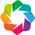

In [1]:
import holoviews as hv
hv.notebook_extension('bokeh')

In [2]:
import dask
import dask.dataframe as dd
import pandas as pd
from distributed import Client
client = Client(scheduler_file='/scratch/tmorton/dask/scheduler.json')

In [3]:
from explorer.dataset import QADataset
from explorer.functors import (Mag, MagDiff, CustomFunctor, DeconvolvedMoments, Column,
                            SdssTraceSize, PsfSdssTraceSizeDiff, HsmTraceSize, Seeing,
                            PsfHsmTraceSizeDiff, CompositeFunctor, StarGalaxyLabeller)

# mag_diff = MagDiff('modelfit_CModel', 'base_PsfFlux')
psf_mag = Mag('base_PsfFlux')
gauss_mag = Mag('base_GaussianFlux')
# seeing = CustomFunctor('0.168*2.35*sqrt(0.5*(ext_shapeHSM_HsmPsfMoments_xx**2 + ext_shapeHSM_HsmPsfMoments_yy**2))')
seeing = Seeing()
label = StarGalaxyLabeller()
funcs = CompositeFunctor({'psf':psf_mag, 'gauss':gauss_mag, 'seeing':seeing, 'label':label})

In [4]:
# import sys
# sys.path.append('..')

from explorer.catalog import ParquetCatalog, MatchedCatalog, MultiMatchedCatalog
from explorer.utils import get_visits
import glob, re

def parse_visit(filename):
    m = re.search('visit-(\d+)', filename)
    return int(m.group(1))

def get_test_catalog(n_visits=3):
    coadd_cat = ParquetCatalog(['test_data/HSC-G/tract-8766/forced.parq'])
    filenames = glob.glob('test_data/HSC-G/tract-8766/visit*/catalog.parq')
    filenames.sort()
    visit_cats = [ParquetCatalog([f], name=parse_visit(f)) for f in filenames[2:2+n_visits]]
    return MultiMatchedCatalog(coadd_cat, visit_cats, match_registry='test_registry.h5')

In [5]:
cat = get_test_catalog()

In [6]:
cat.match()

In [7]:
data = QADataset(cat, {'psf':psf_mag, 'gauss':gauss_mag, 'seeing':seeing}, flags=['calib_psfUsed', 'qaBad_flag'], client=client)

In [8]:
%time data.df.head()

ValueError: No id name available (looked for ccdId, patchId)?

In [9]:
data.ds

:Dataset   [ra,dec,x,label,calib_psfUsed,qaBad_flag]   (psf,gauss,seeing,match_distance)

In [10]:
%opts Points [width=600, height=400, tools=['hover'], color_index='y', colorbar=True] (cmap='coolwarm', size=4) 
from holoviews.operation import decimate
from explorer.plots import FilterStream
filter_stream = FilterStream()
dmap = data.visit_explore(filter_stream=filter_stream)
dmap

:DynamicMap   [visit,y,x_max,label]

In [11]:
from explorer.plots import scattersky, multi_scattersky, FilterStream

multi_scattersky(data.ds.groupby('label'), filter_stream=filter_stream)

:Layout
   .DynamicMap.I    :DynamicMap   [label]
   .DynamicMap.II   :DynamicMap   [label]
   .DynamicMap.III  :DynamicMap   [label]
   .DynamicMap.IV   :DynamicMap   [label]
   .DynamicMap.V    :DynamicMap   [label]
   .DynamicMap.VI   :DynamicMap   [label]
   .DynamicMap.VII  :DynamicMap   [label]
   .DynamicMap.VIII :DynamicMap   [label]
   .DynamicMap.IX   :DynamicMap   [label]
   .DynamicMap.X    :DynamicMap   [label]
   .DynamicMap.XI   :DynamicMap   [label]
   .DynamicMap.XII  :DynamicMap   [label]

In [2]:
# For getting real data
from explorer.catalog import ParquetCatalog, MultiMatchedCatalog
from explorer.utils import get_visits

def get_coadd(rerun, filt, tracts, unforced=False):
    table = 'unforced' if unforced else 'forced'
    files = ['{}/plots/{}/tract-{}/{}.parq'.format(rerun, filt, t, table) for t in tracts]
    return ParquetCatalog(files)
    
def get_visit(rerun, filt, tract, visit):
    file = '{}/plots/{}/tract-{}/visit-{}/catalog.parq'.format(rerun, filt, tract, visit)
    return ParquetCatalog([file], name=float('{}.{}'.format(tract,visit)))

def get_matched_catalog(rerun, filt, tracts, field):
    coadd_cat = get_coadd(rerun, filt, tracts)
    visits = {t:get_visits(field, t, filt) for t in tracts}
    visit_cats = [get_visit(rerun, filt, t, v) for t in tracts for v in visits[t]]
    return MultiMatchedCatalog(coadd_cat, visit_cats, match_registry='match_registry.h5')

In [6]:
rerun = '/scratch/tmorton/hscRerun/DM-12043/SSP_DEEP_XMM_LSS'
field = 'DEEP'
tracts = [8766]#, 8767]
filts = ['HSC-G']#, 'HSC-R']#, 'HSC-I', 'HSC-Z', 'HSC-Y']
cats = {f:get_matched_catalog(rerun, f, tracts, 'DEEP') for f in filts}

In [7]:
cat = cats['HSC-G']

In [8]:
cat.match()

In [9]:
from explorer.plots import multi_scattersky
from explorer.dataset import QADataset

In [10]:
data = {f:QADataset(cats[f], {'psf':psf_mag, 'gauss':gauss_mag, 'seeing':seeing}, flags=['calib_psfUsed', 'qaBad_flag'], client=client) for f in filts}

In [11]:
%time data['HSC-G'].df.head()

CPU times: user 1min 11s, sys: 13.4 s, total: 1min 24s
Wall time: 1min 42s


calib_psfUsed                                              \
                          coadd 8766.15202 8766.15204 8766.15206 8766.15208   
id                                                                            
38553275716337665         False        NaN        NaN        NaN      False   
38553275716337666         False        NaN        NaN        NaN        NaN   
38553275716337667         False        NaN        NaN        NaN      False   
38553275716337668         False        NaN        NaN        NaN      False   
38553275716337669         False        NaN        NaN      False      False   

                                                                        ...   \
                  8766.1522 8766.1523 8766.15232 8766.15242 8766.15244  ...    
id                                                                      ...    
38553275716337665       NaN       NaN        NaN        NaN        NaN  ...    
38553275716337666       NaN       NaN        NaN        NaN        NaN  ...    
38553275716337667     False       NaN        NaN        NaN      False  ...    
38553275716337668       NaN       NaN      False        NaN      False  ...    
38553275716337669       NaN       NaN      False        NaN      False  ...    

                  match_distance                                             \
                      8766.15244 8766.4236 8766.42362 8766.42366 8766.42368   
id                                                                            
38553275716337665            NaN       NaN   0.310316        NaN   0.216019   
38553275716337666            NaN       NaN        NaN        NaN   0.121946   
38553275716337667       0.128770       NaN   0.094909        NaN   0.128060   
38553275716337668       0.092361       NaN   0.057760        NaN   0.012509   
38553275716337669       0.143439       NaN   0.201162        NaN   0.175009   

                                                                    
                  8766.42372 8766.42374 8766.42378 8766.4238 coadd  
id                                                                  
38553275716337665        NaN   0.189845        NaN  0.155790   0.0  
38553275716337666        NaN        NaN        NaN       NaN   0.0  
38553275716337667        NaN   0.187418        NaN  0.070961   0.0  
38553275716337668        NaN   0.030445        NaN  0.013816   0.0  
38553275716337669        NaN   0.313168        NaN  0.231344   0.0  

[5 rows x 180 columns]

In [12]:
data['HSC-G'].ds

:Dataset   [ra,dec,x,label,calib_psfUsed,qaBad_flag]   (psf,gauss,seeing,match_distance)

In [13]:
%opts Points [width=800, height=600, tools=['hover'], color_index='y', colorbar=True] (cmap='coolwarm', size=4) {+framewise}
from holoviews.operation import decimate
from explorer.plots import FilterStream
filter_stream = FilterStream()
dmap = data['HSC-G'].visit_explore(filter_stream=filter_stream)
dmap

:DynamicMap   [visit,y,x_max,label]

In [14]:
from explorer.plots import FilterStream, multi_scattersky

multi_scattersky(data['HSC-G'].ds.groupby('label'), filter_stream=filter_stream)

:Layout
   .DynamicMap.I    :DynamicMap   [label]
   .DynamicMap.II   :DynamicMap   [label]
   .DynamicMap.III  :DynamicMap   [label]
   .DynamicMap.IV   :DynamicMap   [label]
   .DynamicMap.V    :DynamicMap   [label]
   .DynamicMap.VI   :DynamicMap   [label]
   .DynamicMap.VII  :DynamicMap   [label]
   .DynamicMap.VIII :DynamicMap   [label]
   .DynamicMap.IX   :DynamicMap   [label]
   .DynamicMap.X    :DynamicMap   [label]
   .DynamicMap.XI   :DynamicMap   [label]
   .DynamicMap.XII  :DynamicMap   [label]

In [16]:
%%opts RGB [width=500, height=400]

from explorer.plots import skyplot, skyplot_layout

select_dict = dict(x=(None, 23), label='star')
width=None; height=None
# width=30; height=30

skyplot_layout([skyplot.instance(vdim=vdim, width=width, height=height)(data[f].ds.select(**select_dict)).relabel('{}: {}'.format(f, vdim)) for f in filts for vdim in ['psf', 'gauss']]).cols(2)

:Layout
   .DynamicMap.HSC_hyphen_minus_G_colon_psf   :DynamicMap   []
   .DynamicMap.HSC_hyphen_minus_G_colon_gauss :DynamicMap   []
   .DynamicMap.HSC_hyphen_minus_R_colon_psf   :DynamicMap   []
   .DynamicMap.HSC_hyphen_minus_R_colon_gauss :DynamicMap   []

In [34]:
d = QADataset(data['HSC-R'].catalog, seeing)

In [35]:
d.ds

:Dataset   [ra,dec,x,label]   (y0,match_distance)

In [ ]:
# coverage plot, 

In [ ]:
skyplot()

In [26]:
from explorer.plots import FlagSetter
import parambokeh

flag_setter = FlagSetter(filter_stream=filter_stream, flags=data['HSC-R'].flags, bad_flags=data['HSC-R'].flags)
parambokeh.Widgets(flag_setter, callback=flag_setter.event, push=False, on_init=True)

In [17]:
import re
[c for c in data['HSC-G'].catalog.visit_cats[0].columns if re.search('_xx', c) and c in data['HSC-G'].catalog.coadd_cat.columns]

['base_SdssShape_xx',
 'base_SdssShape_psf_xx',
 'ext_shapeHSM_HsmPsfMoments_xx',
 'ext_shapeHSM_HsmSourceMoments_xx',
 'slot_Shape_xx']

In [21]:
seeing = CustomFunctor('2.35*sqrt(0.5*(ext_shapeHSM_HsmPsfMoments_xx**2 + ext_shapeHSM_HsmPsfMoments_yy**2))')

In [20]:
seeing.columns

['ext_shapeHSM_HsmPsfMoments_xx', 'ext_shapeHSM_HsmPsfMoments_yy']

In [22]:
seeing(data['HSC-R'].catalog.coadd_cat)

id
38553275716337665    4.989168
38553275716337666    4.990679
38553275716337667    4.580956
38553275716337668    4.574470
38553275716337669    4.578104
38553275716337670    4.401695
38553275716337671    4.403704
38553275716337672    4.593020
38553275716337673    4.199799
38553275716337674    4.602491
38553275716337675    4.603834
38553275716337676    4.656324
38553275716337677    4.002828
38553275716337678    4.282458
38553275716337679    4.587107
38553275716337680    4.322673
38553275716337681    4.283019
38553275716337682    4.591780
38553275716337683    4.388900
38553275716337684    4.603769
38553275716337685    7.179503
38553275716337686    4.573209
38553275716337687    4.588405
38553275716337688    4.400726
38553275716337689    4.580279
38553275716337690    4.603076
38553275716337691    4.606169
38553275716337692    4.595001
38553275716337693    4.389907
38553275716337694    4.504580
                       ...   
38554263558824450    3.038279
38554263558824451    3.038078
3855426

In [79]:
from lsst.daf.persistence import Butler
butler = Butler(rerun)

In [83]:
dataId = dict(visit=15202, filter='HSC-G', tract=8766, ccd=0)
exp = butler.get('calexp', dataId=dataId)



In [100]:
import lsst.afw.coord as afwCoord
import lsst.afw.geom as afwGeom
import lsst.afw.image as afwImage

def sub_image(exposure, ra, dec, width=100, height=100):
    
    pos = afwCoord.IcrsCoord(ra*afwGeom.degrees, dec*afwGeom.degrees) 
    wcs = exposure.getWcs()
    pixel = afwGeom.Point2I(wcs.skyToPixel(pos))
    box = afwGeom.Box2I()  # empty
    box.include(pixel)  # one pixel
    box.grow(afwGeom.Extent2I(width, height))
    sub = exposure[box, afwImage.PARENT]
    return sub

In [1]:
import lsst.afw.display

In [2]:
lsst.afw.display.setDefaultBackend("ginga")

RuntimeError: Unable to set backend to ginga: "No module named 'lsst.afw.display.ginga'"

In [3]:
import ginga

ModuleNotFoundError: No module named 'ginga'

In [101]:
ra, dec = (35.522, -4.502)
sub = sub_image(exp, ra, dec)

LengthError: 
  File "src/image/Image.cc", line 80, in static lsst::afw::image::ImageBase<PixelT>::_view_t lsst::afw::image::ImageBase<PixelT>::_makeSubView(const Extent2I&, const Extent2I&, const _view_t&) [with PixelT = float; lsst::afw::image::ImageBase<PixelT>::_view_t = boost::gil::image_view<boost::gil::memory_based_2d_locator<boost::gil::memory_based_step_iterator<boost::gil::pixel<float, boost::gil::layout<boost::mpl::vector1<boost::gil::gray_color_t> > >*> > >; lsst::afw::geom::Extent2I = lsst::afw::geom::Extent<int, 2>]
    Box2I(Point2I(6291,-6184),Extent2I(201,201)) doesn't fit in image 2048x4176 {0}
lsst::pex::exceptions::LengthError: 'Box2I(Point2I(6291,-6184),Extent2I(201,201)) doesn't fit in image 2048x4176'
